## DCGAN

### GAN
![目标函数](./imgs/1_1.png)
![训练过程](./imgs/1_2.png)


### DCGAN

#### 转置卷积（transposed convolution）
转置卷积（Transpose Convolution），一些地方也称为“反卷积”，在深度学习中表示为卷积的一个逆向过程，可以根据卷积核大小和输出的大小，**恢复卷积前的图像尺寸**，而不是恢复原始值。

[卷积动态图](https://github.com/vdumoulin/conv_arithmetic)

##### 上采样
上采样（upsampling），又叫**放大图像**、图像插值(interpolating)，主要目的是放大原图像，从而可以显示在更高分辨率的显示设备上。上采样有3种常见的方法：双线性插值(bilinear)，转置卷积(Transposed Convolution)，反池化(Unpooling)。

- 插值法：最近邻算法、双线性插值算法、双三次插值算法（bicubic）
- 反卷积：又称为转置卷积
- 反池化：平均池化的反池化是把池化后的平均数字结果分布到池化前图像上的每个像素格子上。 最大池化的反池化是把池化后的最大数字结果填充到池化前图像上对应的像素格子上，而其他格子则填充0。

##### 下采样
下采样（subsampled）或降采样（downsampled）或者称为**缩小图像**，它的主要目的有两个：1、使得图像符合显示区域的大小；2、生成对应图像的缩略图。

下采样一般为池化操作。池化最直观的作用便是降维，常见的池化有最大池化、平均池化和随机池化；池化层不需要训练参数。

DCGAN的出发点并不是更改损失函数或者是对GAN的原理进行剖析，而是**直接的对网络结构施加限制从而实现更为强大的生成模型**，所以我们可以直接将DCGAN的设计方案嵌入到自己的GAN网络中。即DCGAN和GAN算法相同，但实现上包含一些技巧：
- 使用指定步长的卷积层代替池化层
- 生成器和判别器中都使用BN
- 移除全连接层
- 生成器除去输出层采用Tanh外，全部使用ReLU作为激活函数
- 判别器所有层都使用LeakyReLU作为激活函数


In [2]:
#%matplotlib inline
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)


Random Seed:  3379829627


In [2]:
# Return the same `torch.Generator` object.
torch.manual_seed(manualSeed)

#### 1.input

In [10]:
"""
define inputs

- 使用Celeb-A Faces dataset，下载文件为img_align_celeba.zip，确保将其解压并放入指定目录：
data/celeba
    -> img_align_celeba
        -> 188242.jpg
        -> 173822.jpg
        -> 284702.jpg
        -> 537394.jpg

"""
# Root directory for dataset
dataroot = "/mnt/37bdf30c-6275-4c74-8911-fe112425def1/dataset/CelebA/Img"

# Number of workers for dataloader
workers = 8

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images.
# For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
# Generator is designed to map the latent space vector(z) to data-space
nz = 100

# Size of feature maps in generator
# keep equal to image size
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

#### 2.Data

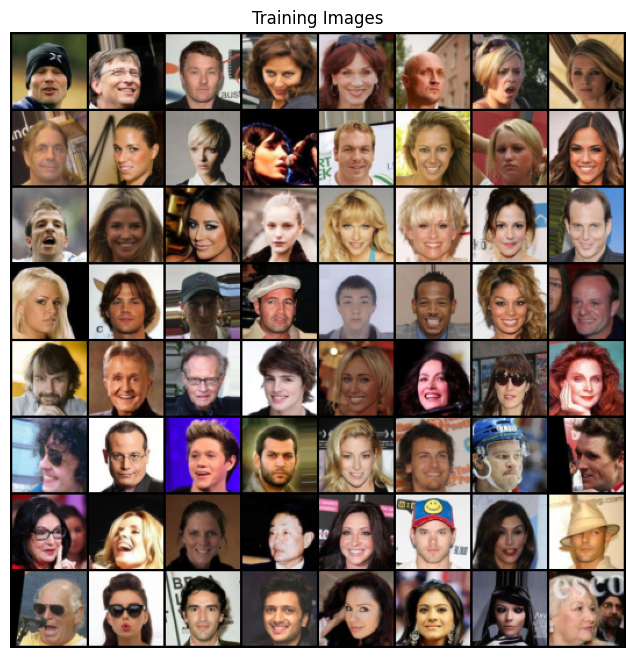

In [11]:
"""
create the dataset, create the dataloader, set the device to run on, and finally visualize some of the training data.
"""

# We can use an image folder dataset the way we have it setup.


# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset,
                                         batch_size=batch_size,
                                         shuffle=True,
                                         num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))


#### 3.Implementation
- weight initialization strategy
- generator
- discriminator
- loss functions
- training loop

##### weight initialization strategy

In [12]:
"""
From the DCGAN paper, the authors specify that all model weights shall be randomly initialized from a Normal distribution with mean=0, stdev=0.02.


"""

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


##### generator
![](./imgs/dcgan_generator.png)

In [13]:
"""
nz:Size of z latent vector (i.e. size of generator input 100)

ngf:Size of feature maps in generator(image size? 64)

"""

# Generator Code


class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( in_channels=nz,
                                out_channels=ngf * 8,
                                kernel_size=4,
                                stride=1,
                                padding=0,
                                bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4

            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8

            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16

            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32

            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        # 将nn.Sequential重新包装，前向过程变的简单，但不利于纠错
        return self.main(input)



# Create the generator
netG = Generator(ngpu).to(device)
netG,type(netG)

(Generator(
   (main): Sequential(
     (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
     (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (2): ReLU(inplace=True)
     (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (5): ReLU(inplace=True)
     (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (8): ReLU(inplace=True)
     (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (11): ReLU(inplace=True)
     (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (13

In [14]:
netG.main

Sequential(
  (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (5): ReLU(inplace=True)
  (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (8): ReLU(inplace=True)
  (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): ReLU(inplace=True)
  (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (13): Tanh()
)

In [15]:
# Generate batch of latent vectors
# 设置的latent var size = 100, eventually generate image
# (B,C,H,W)
X=torch.rand(size=(1,100,1,1)).to(device)
netG(X).shape

torch.Size([1, 3, 64, 64])

In [41]:
for blk in netG.main:
    X = blk(X)
    print(blk.__class__.__name__,'output shape:\t',X.shape)

ConvTranspose2d output shape:	 torch.Size([1, 512, 4, 4])
BatchNorm2d output shape:	 torch.Size([1, 512, 4, 4])
ReLU output shape:	 torch.Size([1, 512, 4, 4])
ConvTranspose2d output shape:	 torch.Size([1, 256, 8, 8])
BatchNorm2d output shape:	 torch.Size([1, 256, 8, 8])
ReLU output shape:	 torch.Size([1, 256, 8, 8])
ConvTranspose2d output shape:	 torch.Size([1, 128, 16, 16])
BatchNorm2d output shape:	 torch.Size([1, 128, 16, 16])
ReLU output shape:	 torch.Size([1, 128, 16, 16])
ConvTranspose2d output shape:	 torch.Size([1, 64, 32, 32])
BatchNorm2d output shape:	 torch.Size([1, 64, 32, 32])
ReLU output shape:	 torch.Size([1, 64, 32, 32])
ConvTranspose2d output shape:	 torch.Size([1, 3, 64, 64])
Tanh output shape:	 torch.Size([1, 3, 64, 64])


In [16]:
# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
netG

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

##### discriminator
As mentioned, the discriminator, **D**, is a binary classification network that takes an image(3x64x64) as input and **outputs a scalar probability** that the input image is real (as opposed to fake).


In [17]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(in_channels=nc,
                      out_channels=ndf,
                      kernel_size=4,
                      stride=2,
                      padding=1,
                      bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32

            nn.Conv2d(in_channels=ndf,
                      out_channels=ndf * 2,
                      kernel_size=4,
                      stride=2,
                      padding=1,
                      bias=False),
            nn.BatchNorm2d(num_features=ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16

            nn.Conv2d(in_channels=ndf * 2,
                      out_channels=ndf * 4,
                      kernel_size=4,
                      stride=2,
                      padding=1,
                      bias=False),
            nn.BatchNorm2d(num_features=ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8

            nn.Conv2d(in_channels=ndf * 4,
                      out_channels=ndf * 8,
                      kernel_size=4,
                      stride=2,
                      padding=1,
                      bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4

            nn.Conv2d(in_channels=ndf * 8,
                      out_channels=1,
                      kernel_size=4,
                      stride=1,
                      padding=0,
                      bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


##### Loss Functions and Optimizers
![dcgan_loss](./imgs/dcgan_loss.png)


In [18]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

##### Training
![dcgan_train](./imgs/dcgan_train.png)

In [19]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/5][0/1583]	Loss_D: 2.0043	Loss_G: 5.3747	D(x): 0.6277	D(G(z)): 0.7023 / 0.0070
[0/5][50/1583]	Loss_D: 0.2610	Loss_G: 20.2145	D(x): 0.9273	D(G(z)): 0.0000 / 0.0000
[0/5][100/1583]	Loss_D: 2.7849	Loss_G: 19.4179	D(x): 0.9868	D(G(z)): 0.7220 / 0.0000
[0/5][150/1583]	Loss_D: 1.1815	Loss_G: 12.7854	D(x): 0.9621	D(G(z)): 0.5854 / 0.0000
[0/5][200/1583]	Loss_D: 0.9714	Loss_G: 5.9864	D(x): 0.9344	D(G(z)): 0.4887 / 0.0097
[0/5][250/1583]	Loss_D: 0.8927	Loss_G: 4.2481	D(x): 0.6037	D(G(z)): 0.0229 / 0.0241
[0/5][300/1583]	Loss_D: 0.5126	Loss_G: 7.8364	D(x): 0.9102	D(G(z)): 0.2948 / 0.0011
[0/5][350/1583]	Loss_D: 0.9622	Loss_G: 2.6988	D(x): 0.4947	D(G(z)): 0.0289 / 0.1078
[0/5][400/1583]	Loss_D: 0.5274	Loss_G: 3.3137	D(x): 0.8127	D(G(z)): 0.2083 / 0.0635
[0/5][450/1583]	Loss_D: 0.6077	Loss_G: 5.2803	D(x): 0.8926	D(G(z)): 0.3198 / 0.0105
[0/5][500/1583]	Loss_D: 0.5195	Loss_G: 4.8288	D(x): 0.8636	D(G(z)): 0.2625 / 0.0145
[0/5][550/1583]	Loss_D: 0.5103	Loss_G: 5.1611	D(x)

#### 4.Results
- how D and G’s losses changed during training
- visualize G’s output on the fixed_noise batch for every epoch
- a batch of real data next to a batch of fake data from G

##### Loss versus training iteration

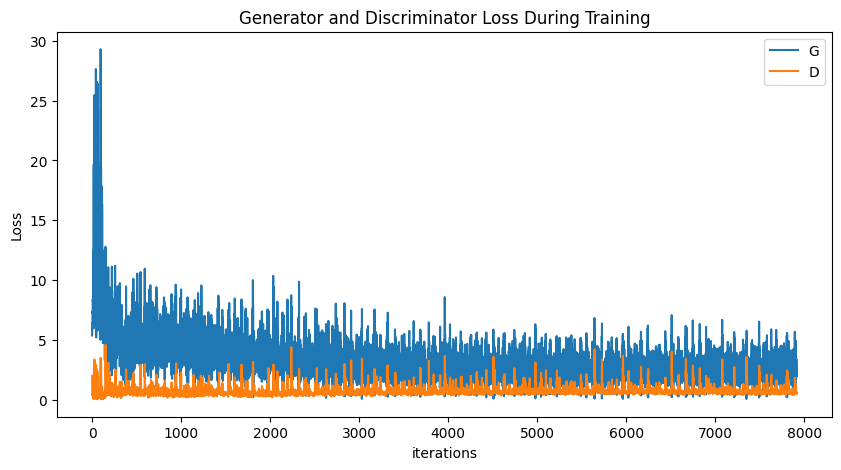

In [20]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

##### Visualization of G’s progression

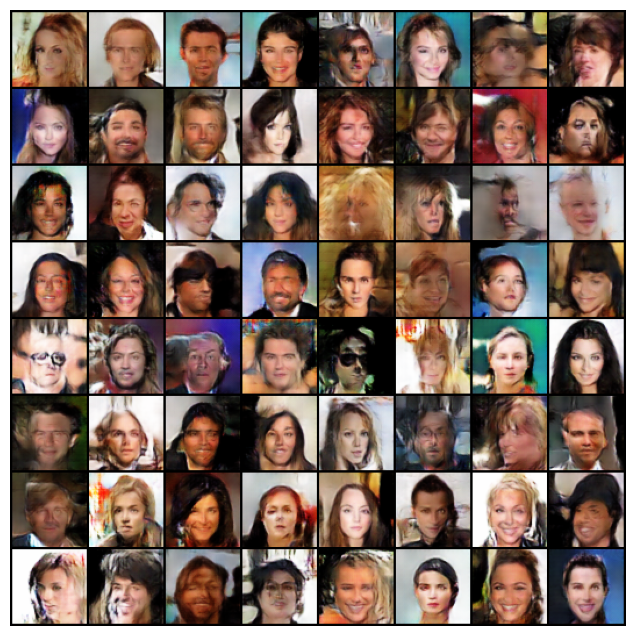

In [21]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")

ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]

ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

##### Real Images vs. Fake Images

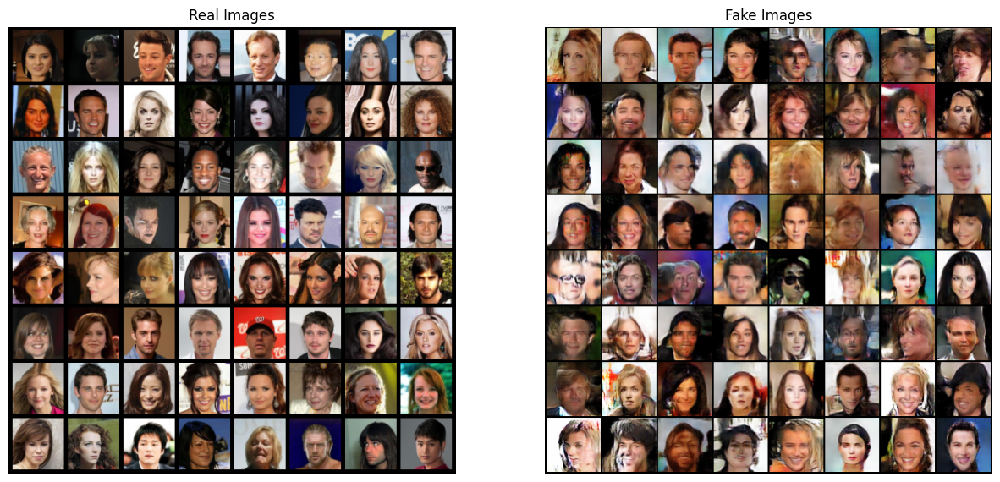

In [22]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()